In [11]:
#Import libraries
import pandas as pd
import matplotlib.pyplot as plt
#from ipyleaflet import Map
import seaborn as sns

In [13]:
#Load filter and translated data for analysis
df_md = pd.read_csv('metadata_eng.csv')
df_prod = pd.read_csv('production_eng.csv')
df_hf = pd.read_csv('hf_eng.csv')

### Number of wells listed in the metadata by type

In [21]:
#Check if wells are unique
print(df_md.shape)
print(len(df_md['idwell'].unique()))

(80011, 11)
80011


In [13]:
df_md.head(5)

,Unnamed: 0,idwell,wellname,longitude,latitude,reservoir_type,basin,concession,elevation,depth,dates
0,0,144081,315,-69.090268,-38.931958,NaN,NEUQUINA,BAJO BAGUALES,533.79,550.0,NaN
1,1,39200,A-1,-68.698460,-33.648430,NaN,CUYANA,ATAMISQUI,1118.62,2144.0,NaN
2,2,46697,A.10,-69.014850,-45.904920,NaN,GOLFO SAN JORGE,ANTICLINAL GRANDE - CERRO DRAGON,384.22,1086.0,NaN
3,3,46698,A.11,-69.049350,-45.813060,NaN,GOLFO SAN JORGE,ANTICLINAL GRANDE - CERRO DRAGON,307.95,838.0,NaN
4,4,46699,A.12,-68.925710,-45.777890,NaN,GOLFO SAN JORGE,ANTICLINAL GRANDE - CERRO DRAGON,292.70,1175.0,NaN


In [8]:
df_md.describe()

,Unnamed: 0,idwell,longitude,latitude,elevation,depth
count,80011.000000,80011.000000,80011.000000,80011.000000,80011.000000,80011.000000
mean,40005.000000,99183.964780,-68.390689,-42.392986,498.055164,1608.380302
std,23097.330531,41849.387381,0.849327,5.240070,311.929848,1667.273985
min,0.000000,212.000000,-72.105900,-54.024240,-100.000000,0.000000
25%,20002.500000,68912.500000,-69.035362,-46.376357,306.000000,1004.000000
50%,40005.000000,108069.000000,-68.366407,-45.724050,424.000000,1550.000000
75%,60007.500000,129798.500000,-67.848520,-38.004621,645.080000,2300.000000
max,80010.000000,161992.000000,-57.760390,-22.002550,5543.410000,378939.000000


In [9]:
df_md['reservoir_type'].unique()

array([nan, 'CONVENCIONAL', 'SIN RESERVORIO', 'NO CONVENCIONAL'],
      dtype=object)

In [10]:
reservoir_type_dict = {
    'CONVENCIONAL': 'conventional',
    'NO CONVENCIONAL': 'unconventional',
    'SIN RESERVORIO': 'no_reservoir'
}
df_md['reservoir_type'] = df_md['reservoir_type'].replace(reservoir_type_dict)

In [11]:
df_md['reservoir_type'].unique()

array([nan, 'conventional', 'no_reservoir', 'unconventional'],
      dtype=object)

In [22]:
df_md['reservoir_type'] = df_md['reservoir_type'].fillna('no_category')
df_md.groupby('reservoir_type').count()['wellname']

reservoir_type
conventional      53927
no_category       23095
no_reservoir        302
unconventional     2687
Name: wellname, dtype: int64

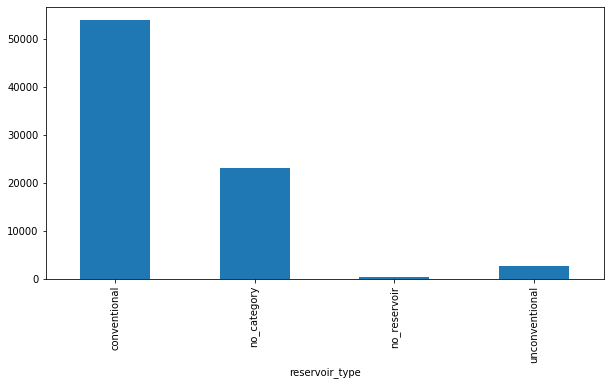

In [23]:
plt.figure(figsize=(10,5))
df_md.groupby('reservoir_type').count()['wellname'].plot.bar()

In [26]:
# Amount of unique idwells in the production data
len(df_prod['idwell'].unique())

2705

### Number of unconventional wells per basin

In [28]:
# Number of unconventional wells per basin
df_md_unc = df_md[df_md['reservoir_type']=='unconventional']
df_md_unc.groupby('basin').count()['wellname']

basin
AUSTRAL             117
GOLFO SAN JORGE       2
NEUQUINA           2567
NOROESTE              1
Name: wellname, dtype: int64

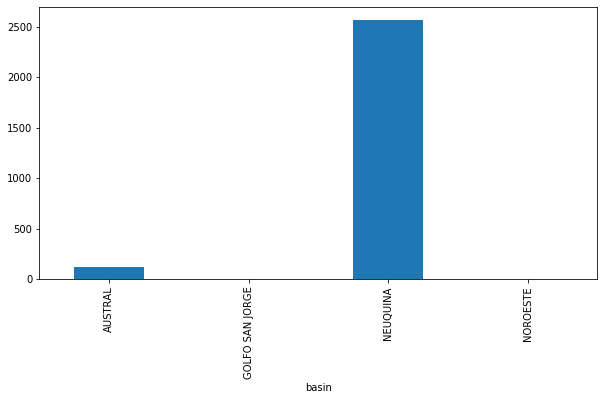

In [30]:
plt.figure(figsize=(10,5))
df_md_unc.groupby('basin').count()['wellname'].plot.bar()

### Number of wells in Neuquina basin per concession (top 10 concessions)

In [35]:
df_md_unc_neuquina = df_md_unc[df_md_unc['basin']=='NEUQUINA']
df_md_unc_neuquina.groupby('concession').count()['wellname'].sort_values(ascending=False)[:10]

concession
LOMA CAMPANA                     628
LOMA LA LATA - SIERRA BARROSA    230
ESTACION FERNANDEZ ORO           194
RINCON DEL MANGRULLO             151
AGUA DEL CAJON                   148
CENTENARIO CENTRO                135
LINDERO ATRAVESADO               119
AGUADA PICHANA ESTE               87
EL OREJANO                        85
FORTIN DE PIEDRA                  82
Name: wellname, dtype: int64

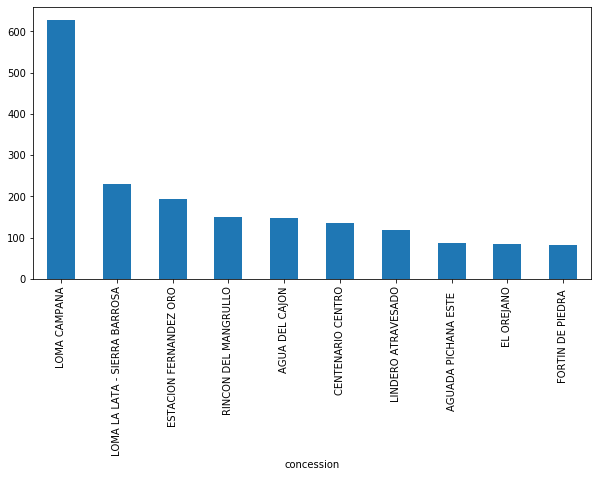

In [37]:
plt.figure(figsize=(10,5))
df_md_unc_neuquina.groupby('concession').count()['wellname'].sort_values(ascending=False)[:10].plot.bar()

### Map of wells in Neuquina basin per concession (top 10 concessions)

In [38]:
df_md_unc_neuquina.columns

Index(['Unnamed: 0', 'idwell', 'wellname', 'longitude', 'latitude',
       'reservoir_type', 'basin', 'concession', 'elevation', 'depth', 'dates'],
      dtype='object')

### Relationship between HF well data

In [14]:
df_hf.describe()

,Unnamed: 0,idwell,horizontal_length,amount_fractures,national_sand,imported_sand,injected_water,injected_co2,max_pressure,equipment_power_hp
count,2592.000000,2592.000000,2592.000000,2592.000000,2592.000000,2592.000000,2592.000000,2592.000000,2592.000000,2541.000000
mean,1295.500000,141721.918596,503.340810,9.358796,1261.578105,531.276419,11143.659888,9.189043,7529.067035,15038.369306
std,748.390273,38504.715138,845.113091,11.041173,2459.734309,938.433943,25667.426312,46.794827,3544.637532,13127.759917
min,0.000000,458.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,647.750000,144851.500000,0.000000,2.000000,0.000000,18.777500,142.000000,0.000000,4600.000000,834.000000
50%,1295.500000,155239.500000,0.000000,5.000000,0.000000,225.590000,2464.050000,0.000000,7939.500000,18000.000000
75%,1943.250000,159353.250000,1025.250000,13.000000,687.346875,737.055000,10959.250000,0.000000,10800.000000,26000.000000
max,2591.000000,162060.000000,3387.000000,71.000000,14416.200000,11839.640000,537184.600000,489.000000,22444.000000,50000.000000


In [16]:
df_hf.head(5)

,Unnamed: 0,idwell,wellname,reservoir_type,horizontal_length,amount_fractures,national_sand,imported_sand,injected_water,injected_co2,max_pressure,equipment_power_hp,dates
0,0,159910,APS.Nq.ADC.xp-1033,NO CONVENCIONAL,0.0,3,0.000,0.000,2718.20,0.0,10190.0,10897.0,2019-06-14 17:13:03.68279
1,1,159910,APS.Nq.ADC.xp-1033,NO CONVENCIONAL,0.0,1,0.000,0.000,600.00,0.0,9250.0,10251.0,2019-06-14 17:14:19.179874
2,2,159219,YPF.Nq.AdlA-1001(h),NO CONVENCIONAL,1437.3,18,3761.370,536.850,25768.30,0.0,15000.0,32000.0,2019-06-27 13:46:21.14935
3,3,159220,YPF.Nq.AdlA-1002(h),NO CONVENCIONAL,1518.3,19,3903.705,558.225,27398.37,0.0,11348.0,32000.0,2019-06-27 13:46:21.14935
4,4,159221,YPF.Nq.AdlA-1003(h),NO CONVENCIONAL,1482.3,19,3949.020,569.925,27157.60,0.0,11076.0,32000.0,2019-06-27 13:46:21.14935


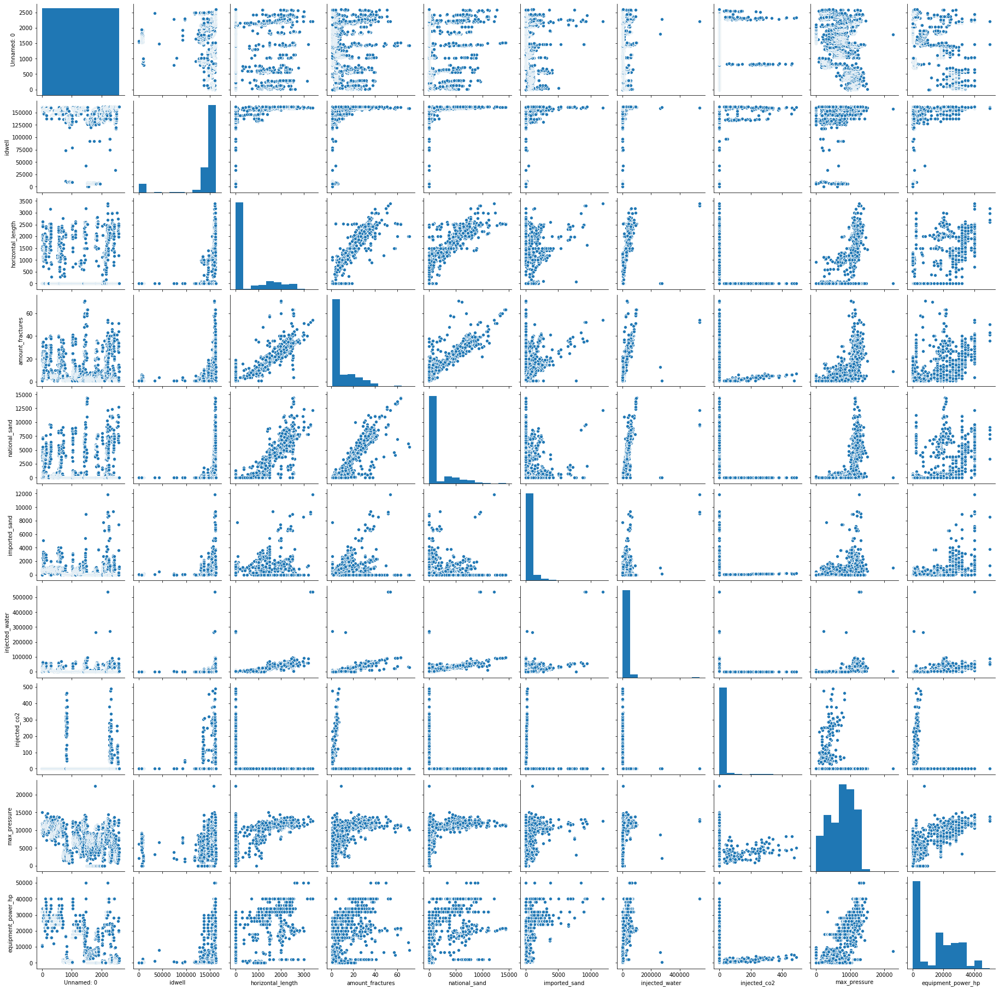

In [15]:
sns.pairplot(df_hf)

### Count the number of wells per year per well type (horizontal, vertical, deviated)

In [17]:
df_prod.columns

Index(['Unnamed: 0', 'idcompany', 'wellname', 'year', 'month', 'idwell',
       'oilprod', 'gasprod', 'waterprod', 'waterinj', 'gasinj', 'co2inj',
       'effective_time', 'extraction_type', 'company', 'depth', 'formation',
       'basin', 'longitude', 'latitude', 'resource_type', 'classification',
       'dates'],
      dtype='object')

In [18]:
df_prod.head(10)

,Unnamed: 0,idcompany,wellname,year,month,idwell,oilprod,gasprod,waterprod,waterinj,...,extraction_type,company,depth,formation,basin,longitude,latitude,resource_type,classification,dates
0,0,YSUR,APA.RN.EFO-221(d),2015,1,143845,103.16,769.01,61.42,0.0,...,Surgencia Natural,YSUR ENERGÍA ARGENTINA S.R.L.,3783.0,lajas,NEUQUINA,-67.823099,-39.023308,NO CONVENCIONAL,EXPLOTACION,2015-01-31
1,1,YSUR,APA.RN.EFO-225(d),2015,1,146140,319.61,1737.79,105.75,0.0,...,Surgencia Natural,YSUR ENERGÍA ARGENTINA S.R.L.,3856.0,lajas,NEUQUINA,-67.810654,-39.023781,NO CONVENCIONAL,EXPLOTACION,2015-01-31
2,2,YSUR,APA.RN.EFO-227(d),2015,1,137716,88.34,583.25,24.94,0.0,...,Surgencia Natural,YSUR ENERGÍA ARGENTINA S.R.L.,3850.0,lajas,NEUQUINA,-67.822612,-39.023428,NO CONVENCIONAL,EXPLOTACION,2015-01-31
3,3,YSUR,APA.NQ.Gu-1160,2015,1,134173,28.50,627.54,31.62,0.0,...,Surgencia Natural,YSUR ENERGÍA ARGENTINA S.R.L.,2955.0,precuyo,NEUQUINA,-69.227769,-38.863944,NO CONVENCIONAL,EXPLOTACION,2015-01-31
4,4,YSUR,APA.Nq.Gu-1184(d),2015,1,137212,0.00,422.11,0.00,0.0,...,Bombeo Mecánico,YSUR ENERGÍA ARGENTINA S.R.L.,3305.0,basamento,NEUQUINA,-69.255971,-38.860779,NO CONVENCIONAL,EXPLOTACION,2015-01-31
5,5,YSUR,APA.Nq.Gu-1203(d),2015,1,137717,0.00,28.67,0.00,0.0,...,Bombeo Mecánico,YSUR ENERGÍA ARGENTINA S.R.L.,3685.0,basamento,NEUQUINA,-69.227797,-38.863756,NO CONVENCIONAL,EXPLOTACION,2015-01-31
6,6,YSUR,APA.Nq.Gu-1198,2015,1,137095,3.94,925.01,99.72,0.0,...,Surgencia Natural,YSUR ENERGÍA ARGENTINA S.R.L.,3645.0,basamento,NEUQUINA,-69.223442,-38.863905,NO CONVENCIONAL,EXPLOTACION,2015-01-31
7,7,YSUR,APA.RN.EFO-233(d),2015,1,145327,368.24,1392.98,98.22,0.0,...,Surgencia Natural,YSUR ENERGÍA ARGENTINA S.R.L.,3850.0,lajas,NEUQUINA,-67.810442,-39.023946,NO CONVENCIONAL,EXPLOTACION,2015-01-31
8,8,YSUR,AEA.RN.EFO-61(I)d,2015,1,132877,0.00,0.00,0.00,0.0,...,Sin Sistema de Extracción,YSUR ENERGÍA ARGENTINA S.R.L.,3025.0,formación improductiva,NEUQUINA,-67.823092,-39.023537,NO CONVENCIONAL,EXPLOTACION,2015-01-31
9,9,YSUR,APA.RN.EFO-231(d),2015,1,153522,574.95,1649.58,655.29,0.0,...,Surgencia Natural,YSUR ENERGÍA ARGENTINA S.R.L.,3844.0,lajas,NEUQUINA,-67.810843,-39.024083,NO CONVENCIONAL,EXPLOTACION,2015-01-31


In [20]:
df_prod_firstrowinitem = df_prod.groupby('idwell').first()

In [21]:
df_prod_firstrowinitem['well_subtype'] = df_prod_firstrowinitem['wellname']

In [24]:
def getwelltype(x):
    x = x.lower()
    well_type = 'vertical'
    if '(h)' in x:
        well_type = 'horizontal'
    elif '(d)' in x:
        well_type = 'deviated'
    return well_type

df_prod_firstrowinitem['well_subtype'] = df_prod_firstrowinitem['well_subtype'].apply(getwelltype)
df_prod_firstrowinitem.head(3)

,Unnamed: 0,idcompany,wellname,year,month,oilprod,gasprod,waterprod,waterinj,gasinj,...,company,depth,formation,basin,longitude,latitude,resource_type,classification,dates,well_subtype
idwell,,,,,,,,,,,,,,,,,,,,,
3640,102787,VOG,PPC.Nq.EC-4,2019,1,51.655,1.314,120.411,0.0,0.0,...,Vista Oil & Gas Argentina SA,2585.0,vaca muerta,NEUQUINA,-68.452390,-37.954170,NO CONVENCIONAL,EXPLOTACION,2019-01-31,vertical
8043,103309,TPT,YPF.Nq.FP.x-2,2006,1,0.000,0.000,0.000,0.0,0.0,...,TECPETROL S.A.,3243.0,vaca muerta,NEUQUINA,-69.038885,-38.508198,NO CONVENCIONAL,EXPLORACION,2006-01-31,vertical
10073,145880,CHE,CSJ.RN.LMa.a-3,2006,1,41.300,2043.590,101.000,0.0,0.0,...,CHEVRON ARGENTINA S.R.L.,3850.0,lajas,NEUQUINA,-67.669980,-38.832360,NO CONVENCIONAL,EXPLOTACION,2006-01-31,vertical


In [25]:
df_prod_firstrowinitem.groupby('well_subtype').count()['wellname']

well_subtype
deviated      1126
horizontal     803
vertical       776
Name: wellname, dtype: int64

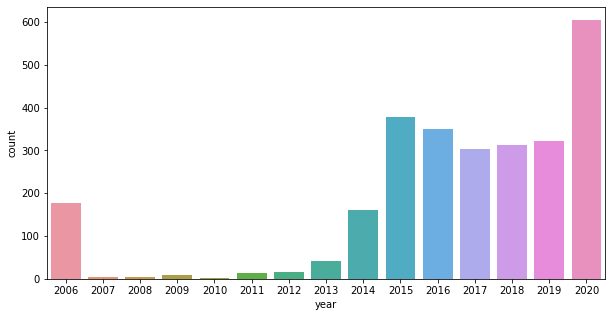

In [27]:
plt.figure(figsize=(10,5))
sns.countplot(x='year', data=df_prod_firstrowinitem)

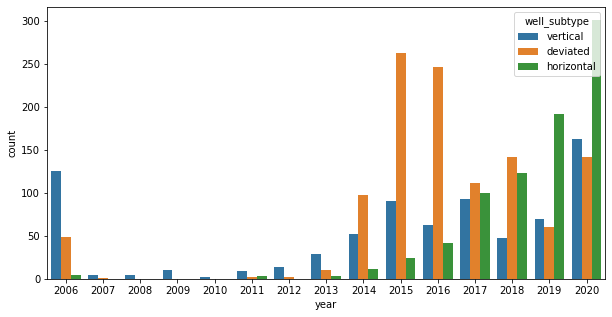

In [28]:
plt.figure(figsize=(10,5))
sns.countplot(x='year', hue='well_subtype', data=df_prod_firstrowinitem)